In [2]:
import json
from collections import Counter
import matplotlib.pyplot as plt
from transformers import BertModel, BertTokenizer
import torch
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler
from transformers import AdamW
from tqdm.auto import tqdm
from torch.nn.utils.rnn import pad_sequence
import torch.nn as nn

In [3]:
tokenizer = BertTokenizer.from_pretrained('kykim/bert-kor-base')

In [3]:
with open("textdata\\talksets-train-1_aihub.json", encoding="utf-8") as file1 :
    data1 = json.load(file1)

with open("textdata\\talksets-train-2.json", encoding="utf-8") as file2 :
    data2 = json.load(file2)

with open("textdata\\talksets-train-3.json", encoding="utf-8") as file3 :
    data3 = json.load(file3)

if isinstance(data1, dict):
    print("data1 : dictionary")
elif isinstance(data1, list):
    print("data1 : list")

if isinstance(data2, dict):
    print("data2 : dictionary")
elif isinstance(data2, list):
    print("data2 : list")

if isinstance(data3, dict):
    print("data3 : dictionary")
elif isinstance(data3, list):
    print("data3 : list")

data1 : list
data2 : list
data3 : list


In [4]:
need_data1 = []
need_data2 = []

num = 1
for obj in data1:
    sentences = obj["sentences"]
    for sentence in sentences:
        text = sentence["text"]
        origin_text = sentence["origin_text"]
        types = sentence["types"]
        is_immoral = sentence["is_immoral"]
        intensity = sentence["intensity"]
        mapped_slots = sentence["mapped_slots"]
        word_list = []
        for word in mapped_slots :
            word_obj = {
                "slot" : word["slot"],
                "token" : word["token"]
            }
            word_list.append(word_obj)
        extracted_data = {
            "id" : num,
            "text" : text,
            "origin_text" : origin_text,
            "types" : types,
            "is_immoral" : is_immoral,
            "intensity" : intensity,
            "word_list" : word_list
        }
        need_data1.append(extracted_data)
        num = num + 1

num = 1
for obj in data2:
    sentences = obj["sentences"]
    for sentence in sentences:
        text = sentence["text"]
        origin_text = sentence["origin_text"]
        types = sentence["types"]
        is_immoral = sentence["is_immoral"]
        intensity = sentence["intensity"]
        mapped_slots = sentence["mapped_slots"]
        word_list = []
        for word in mapped_slots :
            word_obj = {
                "slot" : word["slot"],
                "token" : word["token"]
            }
            word_list.append(word_obj)
        extracted_data = {
            "id" : num,
            "text" : text,
            "origin_text" : origin_text,
            "types" : types,
            "is_immoral" : is_immoral,
            "intensity" : intensity,
            "word_list" : word_list
        }
        need_data2.append(extracted_data)
        num = num + 1

for data in need_data1 :
    print(data)

# for data in need_data2 :
#     if("CRIME" in data["types"]) :
#         print(data)

{'id': 1, 'text': '부랴부랴 왔는데 아무도 안왔네. 시간개념들이 없네', 'origin_text': '부랴부랴 왔는데 아무도 안왔네. 시간개념들이 없네', 'types': ['CENSURE'], 'is_immoral': True, 'intensity': 2.0, 'word_list': [{'slot': 'V1', 'token': '오다'}, {'slot': 'N1', 'token': '아무'}, {'slot': 'V2', 'token': '안오다'}, {'slot': 'N2', 'token': '시간'}, {'slot': 'N3', 'token': '개념들'}, {'slot': 'V3', 'token': '없다'}]}
{'id': 2, 'text': '맞아. 사람들이 진짜 개념이없다', 'origin_text': '맞아. 사람들이 진짜 개념이없다', 'types': ['CENSURE'], 'is_immoral': True, 'intensity': 2.0, 'word_list': [{'slot': 'N1', 'token': '사람들'}, {'slot': 'N2', 'token': '개념'}, {'slot': 'V1', 'token': '없다'}]}
{'id': 3, 'text': '저렇게는 살지 말아야지', 'origin_text': '저렇게는 살지 말아야지', 'types': ['CENSURE'], 'is_immoral': True, 'intensity': 2.0, 'word_list': [{'slot': 'V1', 'token': '저렇다'}, {'slot': 'V2', 'token': '살다'}]}
{'id': 4, 'text': '그러게 게으르고 멍청한 사람들은 맞아야해', 'origin_text': '그러게 게으르고 멍청한 사람들은 맞아야해', 'types': ['CENSURE'], 'is_immoral': True, 'intensity': 2.0, 'word_list': [{'slot': 'V1', 'token': '그러하다'}, {'s

Counter({'CENSURE': 34782, 'IMMORAL_NONE': 30549, 'HATE': 11601, 'DISCRIMINATION': 5801, 'SEXUAL': 3244, 'VIOLENCE': 2720, 'ABUSE': 2221, 'CRIME': 899})
Counter({'IMMORAL_NONE': 30861, 'CENSURE': 30190, 'HATE': 9900, 'DISCRIMINATION': 6215, 'SEXUAL': 3378, 'ABUSE': 3262, 'VIOLENCE': 3020, 'CRIME': 1228})


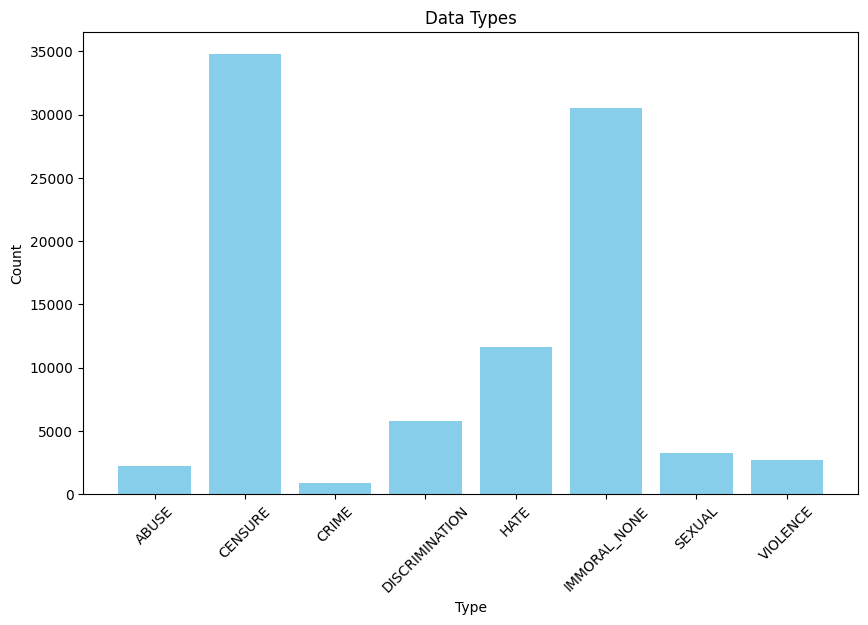

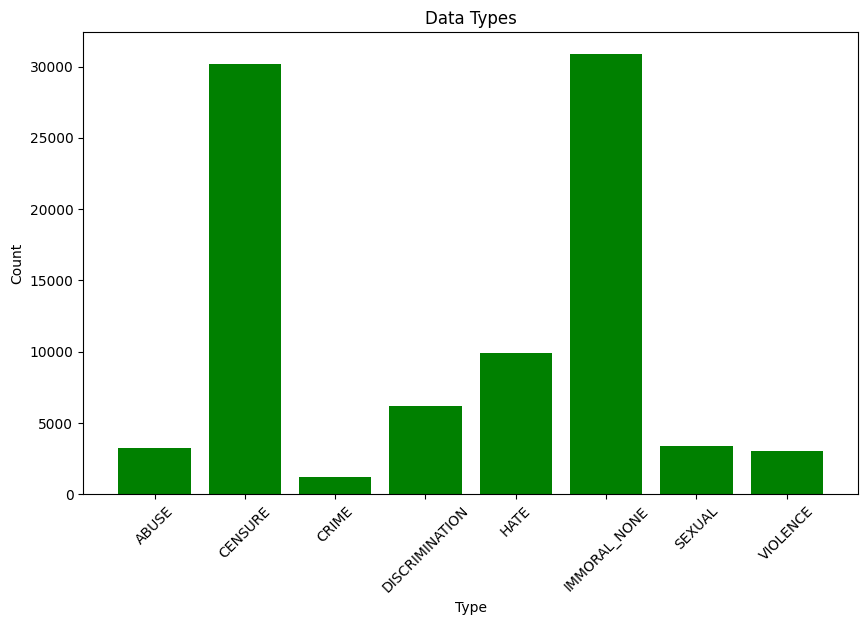

In [5]:
types_list1 = [type for item in need_data1 for type in item['types']]
types_list2 = [type for item in need_data2 for type in item['types']]

types_list1.sort()
types_list2.sort()

# 각 'type'의 발생 횟수를 카운트합니다.
type_counts1 = Counter(types_list1)
type_counts2 = Counter(types_list2)

print(type_counts1)
print(type_counts2)

# 그래프를 그리기 위한 데이터를 준비합니다.
labels1, values1 = zip(*type_counts1.items())
labels2, values2 = zip(*type_counts2.items())

# 그래프를 그립니다.
plt.figure(figsize=(10, 6))
plt.bar(labels1, values1, color='skyblue')
plt.title('Data Types')
plt.xlabel('Type')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

# 그래프를 그립니다.
plt.figure(figsize=(10, 6))
plt.bar(labels2, values2, color='Green')
plt.title('Data Types')
plt.xlabel('Type')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

In [6]:
# 'types' 필드의 고유 값에 대한 인덱스 맵을 만듭니다.
unique_types = set(t for d in need_data1 for t in d['types'])
type_to_index = {t: i for i, t in enumerate(unique_types)}

# 데이터를 준비하는 함수 내에서 'types' 레이블을 숫자로 변환합니다.
def prepare_data(data):
    tokenized_texts = [tokenizer.tokenize(text['text']) for text in data]
    input_ids = [tokenizer.convert_tokens_to_ids(x) for x in tokenized_texts]
    input_ids = pad_sequence([torch.tensor(seq) for seq in input_ids], batch_first=True, padding_value=tokenizer.pad_token_id)

    attention_masks = [[float(i != tokenizer.pad_token_id) for i in seq] for seq in input_ids]
    attention_masks = torch.tensor(attention_masks)

    # 'types' 레이블을 숫자로 인코딩합니다.
    labels = torch.tensor([type_to_index[d['types'][0]] for d in data])

    # 'intensity' 레이블을 준비합니다.
    intensities = torch.tensor([d['intensity'] for d in data])

    return TensorDataset(input_ids, attention_masks, labels, intensities)

# 데이터 준비
train_dataset = prepare_data(need_data1)
test_dataset = prepare_data(need_data2)

batch_size = 8
train_dataloader = DataLoader(train_dataset, sampler=RandomSampler(train_dataset), batch_size=batch_size)
test_dataloader = DataLoader(test_dataset, sampler=SequentialSampler(test_dataset), batch_size=batch_size)

In [4]:
class KoBERTforClassification(nn.Module):
    def __init__(self, num_labels_types, num_labels_intensity):
        super(KoBERTforClassification, self).__init__()
        self.num_labels_types = num_labels_types
        self.num_labels_intensity = num_labels_intensity
        self.bert = BertModel.from_pretrained('kykim/bert-kor-base')
        self.dropout = nn.Dropout(0.1)
        self.classifier_types = nn.Linear(self.bert.config.hidden_size, num_labels_types)
        self.classifier_intensity = nn.Linear(self.bert.config.hidden_size, num_labels_intensity)
    
    def forward(self, input_ids, attention_mask):
        outputs = self.bert(input_ids=input_ids, attention_mask=attention_mask)
        pooled_output = outputs[1]
        pooled_output = self.dropout(pooled_output)
        logits_types = self.classifier_types(pooled_output)
        logits_intensity = self.classifier_intensity(pooled_output)
        return logits_types, logits_intensity

# 모델 인스턴스 생성
model = KoBERTforClassification(num_labels_types=8, num_labels_intensity=1)  # 'types'의 고유값 개수를 지정
model.cuda()

KoBERTforClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(42000, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e-12, eleme

In [8]:

# 최적화 도구 및 손실 함수
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn_types = nn.CrossEntropyLoss()  # 'types' 분류를 위한 손실 함수
loss_fn_intensity = nn.MSELoss()  # 'intensity' 회귀를 위한 손실 함수

# 학습 루프
for epoch in range(1):
    model.train()
    total_loss = 0
    # tqdm 진행도 바 추가
    progress_bar = tqdm(enumerate(train_dataloader), total=len(train_dataloader), desc=f"Epoch {epoch}")
    
    for step, batch in progress_bar:
        batch = tuple(t.cuda() for t in batch)
        b_input_ids, b_input_mask, b_labels_types, b_labels_intensity = batch
        optimizer.zero_grad()
        
        logits_types, logits_intensity = model(b_input_ids, attention_mask=b_input_mask)
        
        loss_types = loss_fn_types(logits_types, b_labels_types)
        loss_intensity = loss_fn_intensity(logits_intensity.squeeze(), b_labels_intensity.float())
        loss = loss_types + loss_intensity
        total_loss += loss.item()
        
        loss.backward()
        optimizer.step()
        
        # 진행도 바 업데이트
        progress_bar.set_postfix({'training_loss': '{:.3f}'.format(loss.item()/len(batch))})

    # 에포크별 평균 손실 계산 및 출력
    avg_train_loss = total_loss / len(train_dataloader)
    print(f"\nEpoch {epoch}, Average Loss {avg_train_loss}")

# 모델의 상태 사전 저장
torch.save(model.state_dict(), 'model.pth')

c:\Users\rjend\IdeaProjects\Capstone\CalendarRecipe-Capstone\backend\AItest\myenv\lib\site-packages\transformers\optimization.py:457: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Epoch 0:   0%|          | 0/8825 [00:00<?, ?it/s]

c:\Users\rjend\IdeaProjects\Capstone\CalendarRecipe-Capstone\backend\AItest\myenv\lib\site-packages\torch\nn\modules\loss.py:535: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)



Epoch 0, Average Loss 1.5576420911015263


In [6]:
# 모델 인스턴스 생성 및 파라미터 로드
model = KoBERTforClassification(num_labels_types=8, num_labels_intensity=1)
model.load_state_dict(torch.load('./textModel/model.pth'))
model.eval()  # 모델을 평가 모드로 설정

# 토크나이저 인스턴스 생성
tokenizer = BertTokenizer.from_pretrained('kykim/bert-kor-base')

# 예측을 수행할 텍스트
text_to_predict = "맞아. 사람들이 진짜 개념이없다"

# 텍스트 전처리
encoded_input = tokenizer(text_to_predict, return_tensors='pt', padding=True, truncation=True, max_length=512)
input_ids = encoded_input['input_ids']
attention_mask = encoded_input['attention_mask']

# 모델 예측
with torch.no_grad():
    logits_types, logits_intensity = model(input_ids, attention_mask=attention_mask)

# 결과 처리
predicted_types = torch.argmax(logits_types, dim=1)
predicted_intensity = logits_intensity.squeeze()

if(predicted_types == 0) :
    type_text = "DISCRIMINATION"
elif(predicted_types == 1) :
    type_text = "HATE"
elif(predicted_types == 7) :
    type_text = "IMMORAL_NONE"
else :
    type_text = "Error"

#전생에 나라를 구한 듯.
#우리나라에서는 남자보다 여자가 돈을 잘 버는 것 같아
#그 나라 인간들은 죽으면 죽을 수록 지구에는 이익이다
print(f"text : {text_to_predict}")
print(f"Predicted Types: {predicted_types}, {type_text}")
print(f"Predicted Intensity: {predicted_intensity.item()}")


text : 맞아. 사람들이 진짜 개념이없다
Predicted Types: tensor([3]), Error
Predicted Intensity: 2.371480703353882
